In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#merge feature vector from two batch data
#!cp -r /content/drive/MyDrive/ColabNotebooks_2/AI_CHALLENGE_2023/Dataset/clip-features/* /content/drive/MyDrive/ColabNotebooks_2/AI_CHALLENGE_2023/Dataset/clip-features-vit-b32

#Query Encoder

In [2]:
! pip install ftfy regex tqdm
! pip install git+https://github.com/openai/CLIP.git

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.1/53.1 kB 1.5 MB/s eta 0:00:00
  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-k4houhbx
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-k4houhbx
  Resolved https://github.com/openai/CLIP.git to commit a1d071733d7111c9c014f024669f959182114e33
  Preparing metadata (setup.py) ... done
  Created wheel for clip: filename=clip-1.0-py3-none-any.whl size=1369497 sha256=fe4b9e3fe4bfd5248d658d35cefece193eabf3d3ae007de445beb8fc2aaf897c
  Stored in directory: /tmp/pip-ephem-wheel-cache-2ybngggw/wheels/da/2b/4c/d6691fa9597aac8bb85d2ac13b112deb897d5b50f5ad9a37e4
Successfully built clip


In [3]:
import numpy as np
import torch
from pkg_resources import packaging

print("Torch version:", torch.__version__)

Torch version: 2.0.1+cu118


In [4]:
import clip

clip.available_models()

['RN50',
 'RN101',
 'RN50x4',
 'RN50x16',
 'RN50x64',
 'ViT-B/32',
 'ViT-B/16',
 'ViT-L/14',
 'ViT-L/14@336px']

##Test Encoder query with Clip

In [5]:
model, preprocess = clip.load("ViT-L/14@336px")#ViT vision tranformer
model.cuda().eval()

100%|███████████████████████████████████████| 891M/891M [00:11<00:00, 81.2MiB/s]


CLIP(
  (visual): VisionTransformer(
    (conv1): Conv2d(3, 1024, kernel_size=(14, 14), stride=(14, 14), bias=False)
    (ln_pre): LayerNorm((1024,), eps=1e-05, elementwise_affine=True)
    (transformer): Transformer(
      (resblocks): Sequential(
        (0): ResidualAttentionBlock(
          (attn): MultiheadAttention(
            (out_proj): NonDynamicallyQuantizableLinear(in_features=1024, out_features=1024, bias=True)
          )
          (ln_1): LayerNorm((1024,), eps=1e-05, elementwise_affine=True)
          (mlp): Sequential(
            (c_fc): Linear(in_features=1024, out_features=4096, bias=True)
            (gelu): QuickGELU()
            (c_proj): Linear(in_features=4096, out_features=1024, bias=True)
          )
          (ln_2): LayerNorm((1024,), eps=1e-05, elementwise_affine=True)
        )
        (1): ResidualAttentionBlock(
          (attn): MultiheadAttention(
            (out_proj): NonDynamicallyQuantizableLinear(in_features=1024, out_features=1024, bias=True)


In [6]:
texts=["this is a dog",'this is s cat']
text_tokens = clip.tokenize(texts).cuda()

In [7]:
print(text_tokens.shape)

torch.Size([2, 77])


In [ ]:
with torch.no_grad():
    text_features = model.encode_text(text_tokens).float()

In [ ]:
print(text_features.shape)

torch.Size([2, 512])


In [ ]:
text_features /= text_features.norm(dim=-1, keepdim=True)

In [ ]:
print(text_features.shape)

torch.Size([2, 512])


##Build class query encoder

In [8]:
class TextEmbedding():
  def __init__(self,model_name):
    self.device = "cuda" if torch.cuda.is_available() else "cpu"
    self.model, _ = clip.load(model_name, device=self.device)
    self.model.eval()

  def __call__(self, texts: str) -> np.ndarray:
    text_inputs = clip.tokenize(texts).to(self.device)
    with torch.no_grad():
        text_feature = self.model.encode_text(text_inputs)
        #print(text_feature.shape)
        text_feature /= text_feature.norm(dim=-1, keepdim=True)

    return text_feature.detach().cpu().numpy()

In [9]:
text = ["a presenter wearing a white shirt, glasses,red tie, holding a red box, he is hosting"]
#L01_V002/0248.jpg
text_embedd = TextEmbedding("ViT-L/14@336px")
text_feat_arr = text_embedd(text)[0]
print(text_feat_arr.shape, type(text_feat_arr))

(768,) <class 'numpy.ndarray'>


In [ ]:
text_feat_arr[0]

-0.006744

In [10]:
text = ["a presenter wearing a white shirt, glasses,red tie, holding a red box, he is hosting"]
#L01_V002/0248.jpg
text_embedd = TextEmbedding('ViT-L/14@336px')
text_feat_arr = text_embedd(text)[0]
print(text_feat_arr.shape, type(text_feat_arr))

(768,) <class 'numpy.ndarray'>


In [11]:
text = ["a presenter wearing a white shirt, glasses,red tie, holding a red box, he is hosting"]
#L01_V002/0248.jpg
text_embedd1 = TextEmbedding('ViT-L/14@336px')
# text_feat_arr = text_embedd1(text)[0]
# print(text_feat_arr.shape, type(text_feat_arr))

#Encoder keyframe

##Img Encoder

In [12]:
from PIL import Image
import os
import glob
from typing import List, Tuple
import numpy as np
from tqdm import tqdm


###with clip libaray

In [13]:
class ImageEmbedding():
    def __init__(self,model_name):
        self.device = "cuda" if torch.cuda.is_available() else "cpu"
        self.model, self.preprocess = clip.load(model_name, device=self.device)
        self.model.eval()

    def __call__(self, image_path: str) -> np.ndarray:
        image = Image.open(image_path).convert("RGB")
        image_input = self.preprocess(image).unsqueeze(0).to(self.device)

        with torch.no_grad():
            image_feature = self.model.encode_image(image_input)[0]
            image_feature/= image_feature.norm(dim=-1, keepdim=True)
        return image_feature.detach().cpu().numpy()



In [15]:
# Example usage
image_embedder = ImageEmbedding('ViT-L/14@336px')

image_path = "/content/drive/MyDrive/MinhHuy/ELO@AIC/Dataset/KeyFrames/keyframes_L01/L01_V001/0005.jpg"
image_feat_arr = image_embedder(image_path)

print(type(image_feat_arr))
print(image_feat_arr.shape)


<class 'numpy.ndarray'>
(768,)


###with open_clip_torch library

In [16]:
!pip install open_clip_torch

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 23.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 295.0/295.0 kB 34.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 75.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 93.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 77.9 MB/s eta 0:00:00


In [17]:
import torch
from PIL import Image
import open_clip
device = "cuda" if torch.cuda.is_available() else "cpu"

In [ ]:


model, _, preprocess = open_clip.create_model_and_transforms('ViT-L/14@336px', pretrained='laion2b_s34b_b88k',device =device)
tokenizer = open_clip.get_tokenizer('ViT-L/14@336px')

image = preprocess(Image.open("/content/drive/MyDrive/ELO@AIC/Dataset/KeyFrames/keyframes_L01/L01_V003/0050.jpg")).unsqueeze(0).to(device)
text = tokenizer(["a presenter wearing a white shirt, glasses,red tie, holding a red box, he is hosting", "a dog", "a cat"]).to(device)

with torch.no_grad(), torch.cuda.amp.autocast():
    image_features = model.encode_image(image)
    text_features = model.encode_text(text)
    image_features /= image_features.norm(dim=-1, keepdim=True)
    text_features /= text_features.norm(dim=-1, keepdim=True)

    text_probs = (100.0 * image_features @ text_features.T).softmax(dim=-1)

print("Label probs:", text_probs)  # prints: [[1., 0., 0.]]

In [ ]:
from sklearn.metrics.pairwise import cosine_similarity
import numpy as np
print(cosine_similarity(text_features.squeeze(0).detach().cpu().numpy()[np.newaxis],image_features.squeeze(0).detach().cpu().numpy()[np.newaxis]))

[[0.08748782]]


In [ ]:
import torch
from PIL import Image
import open_clip
from PIL import Image
import os
import glob
from typing import List, Tuple
import numpy as np
from tqdm import tqdm
import torch

In [ ]:
class ImageEmbedding():
    def __init__(self,model_name,pretrain):
        self.device = "cuda" if torch.cuda.is_available() else "cpu"
        self.model,_, self.preprocess = open_clip.create_model_and_transforms(model_name, pretrained=pretrain,device=self.device)
        self.model.eval()
    def __call__(self, image_path: str) -> np.ndarray:
        image = Image.open(image_path)

        image_input = self.preprocess(image).unsqueeze(0).to(self.device)

        with torch.no_grad(), torch.cuda.amp.autocast():
          image_features = self.model.encode_image(image_input)[0]
          image_features /= image_features.norm(dim=-1, keepdim=True)
        return image_features.detach().cpu().numpy()

###Encode

In [ ]:
!mkdir ViT_g_14_laion2b_s34b_b88k_TUAN

In [ ]:
#không cần chạy lại nếu đã chạy và lưu vector feature
PATH_TO_KEYFRAME='/content/drive/MyDrive/ELO@AIC/Dataset/KeyFrames'
SAVE_FEATURE=''
def Encode_Key_frame(model_name,pretrain):

    image_embedder=ImageEmbedding(model_name,pretrain)

    for fold in tqdm(sorted(os.listdir(PATH_TO_KEYFRAME))[:5]):
        path_1=os.path.join(PATH_TO_KEYFRAME,fold)
        for video in sorted(os.listdir(path_1)):
            path_2=os.path.join(path_1,video)
            lst_vec=[]
            for keyframe in sorted(os.listdir(path_2)):
                arr_kf_fea=image_embedder(os.path.join(path_2,keyframe))
                lst_vec.append(arr_kf_fea)
            arr_vd=np.array(lst_vec)
            # print(video)
            # print(arr_vd)
            # print(arr_vd.shape)
            # return arr_vd
            np.save('/content/ViT_g_14_laion2b_s34b_b88k_TUAN/'+video+'.npy', arr_vd)



Encode_Key_frame('ViT-g-14','laion2b_s34b_b88k')




 20%|██        | 1/5 [13:56<55:44, 836.24s/it]

In [ ]:
!cp -r /content/clip_fea_L14_@336px_TUAN /content/drive/MyDrive/ColabNotebooks_2/AI_CHALLENGE_2023

In [ ]:
len(os.listdir('/content/drive/MyDrive/ColabNotebooks_2/AI_CHALLENGE_2023/clip_fea_L14_@336px_TUAN'))

439

In [ ]:
len(os.listdir('/content/clip_fea_L14_@336px_TUAN'))


439

#Test Load feature Clip

In [ ]:
import numpy as np
fea=np.load('/content/L01_V008.npy')

In [ ]:
fea

array([[-0.037   , -0.01707 ,  0.01561 , ..., -0.02454 , -0.02242 ,
         0.005974],
       [-0.003616, -0.013016,  0.003443, ..., -0.009094, -0.006367,
        -0.002655],
       [ 0.009315,  0.0502  ,  0.02356 , ..., -0.012276, -0.005627,
         0.006207],
       ...,
       [-0.0093  ,  0.00732 ,  0.011566, ..., -0.02086 , -0.001974,
         0.01298 ],
       [-0.005894,  0.003983, -0.01038 , ..., -0.004757, -0.00464 ,
         0.009636],
       [ 0.004692,  0.02882 ,  0.00473 , ..., -0.01177 ,  0.009186,
         0.01329 ]], dtype=float16)

In [ ]:
fea2=np.load('/content/drive/MyDrive/ColabNotebooks_2/AI_CHALLENGE_2023/Dataset/clip-features-vit-b32/L01_V008.npy')
fea2

array([[ 0.03348  ,  0.02539  ,  0.01575  , ...,  0.03857  , -0.0437   ,
        -0.005444 ],
       [ 0.001478 , -0.02884  ,  0.01776  , ...,  0.0864   ,  0.012695 ,
         0.00406  ],
       [-0.01164  , -0.00776  , -0.02551  , ...,  0.09204  ,  0.0001153,
        -0.00881  ],
       ...,
       [-0.01553  , -0.03537  ,  0.005154 , ...,  0.0684   , -0.01162  ,
         0.0008245],
       [-0.010796 , -0.03738  , -0.003128 , ...,  0.0634   , -0.00229  ,
         0.00863  ],
       [ 0.00904  , -0.05624  , -0.01058  , ...,  0.0743   , -0.001748 ,
        -0.03488  ]], dtype=float16)

In [ ]:
fea[0].shape

(512,)

In [ ]:
text_feat_arr[np.newaxis].shape

In [ ]:
from sklearn.metrics.pairwise import cosine_similarity

print(cosine_similarity(text_feat_arr[np.newaxis],image_feat_arr[np.newaxis]))

[[0.24256653]]


#Lưu trữ thông tin keyframes và feature của nó

In [ ]:
import os
import glob
from typing import List, Tuple
import numpy as np
from tqdm import tqdm


In [ ]:
#PATH_TO_CLIPFEATURES='/content/drive/MyDrive/ColabNotebooks_2/AI_CHALLENGE_2023/ELO@AIC/Dataset/clip-features/'
#PATH_TO_CLIPFEATURES='/content/clip_fea/'
#PATH_TO_CLIPFEATURES='/content/drive/MyDrive/ColabNotebooks_2/AI_CHALLENGE_2023/Dataset/clip-features-vit-b32/'
PATH_TO_CLIPFEATURES='/content/drive/MyDrive/ColabNotebooks_2/AI_CHALLENGE_2023/Dataset/clip_fea_L14_@336px_TUAN/'


#mỗi ketframe lưu 3 thông tin: tên file video, frame idx, feature vector-> vd: L01_V001,001,vector lưu sao cho truy xuất ra dc keyframe
def Database()-> List[Tuple[str, int, np.ndarray],]:
  data_base=[]
  for name_file_feature in tqdm(sorted(os.listdir(PATH_TO_CLIPFEATURES))):
    vid_name=name_file_feature.split('.')[0]
    features=np.load(os.path.join(PATH_TO_CLIPFEATURES,name_file_feature))
    for idx,feat in enumerate(features,1):
      instance=(vid_name,idx,feat)
      data_base.append(instance)
  return data_base






In [ ]:
db=Database()
print(db[286][:2])
print(db[286][-1].shape)

100%|██████████| 439/439 [00:02<00:00, 212.88it/s]

('L11_V001', 287)
(768,)


In [ ]:
#Load features csv
import pandas as pd
database = pd.read_csv("/content/drive/MyDrive/ColabNotebooks_2/AI_CHALLENGE_2023/ELO@AIC/Features_CSVs/FeatureL14.csv")

In [ ]:
database = database.drop_duplicates(ignore_index=False)
database = database.drop("Unnamed: 0", axis =1 )
database = database.drop("features_dimension", axis =1 )

database

,video_name,frame_index,features_vector
0,L01_V006,0.0,[-3.22265625e-01 5.52978516e-02 8.37890625e-...
1,L01_V006,1.0,[-3.88671875e-01 1.18957520e-01 6.76269531e-...
2,L01_V006,2.0,[ 1.93237305e-01 7.53906250e-01 3.24951172e-...
3,L01_V006,3.0,[-2.97851562e-01 2.78076172e-01 2.69287109e-...
4,L01_V006,4.0,[ 4.12841797e-01 -8.52050781e-01 -6.74438477e-...
...,...,...,...
95375,L10_V012,289.0,[ 8.71582031e-02 -1.15722656e+00 5.72265625e-...
95376,L10_V012,290.0,[ 1.21078491e-02 -1.62890625e+00 7.16308594e-...
95377,L10_V012,291.0,[ 1.89941406e-01 3.25927734e-01 3.64257812e-...
95378,L10_V012,292.0,[ 3.38867188e-01 1.73217773e-01 3.04931641e-...


In [ ]:
import numpy as np
database['features_vector']=database['features_vector'].apply(lambda x: np.fromstring(x.replace('\n','').strip('[]'),dtype=float,sep=' '))
database['frame_index']=database['frame_index'].apply(lambda x: int(x))

In [ ]:
from sklearn.metrics.pairwise import cosine_similarity
cosine_similarity(database['features_vector'][4][np.newaxis],image_feat_arr[np.newaxis])

array([[0.69120384]])

In [ ]:
for i in range(len(database['features_vector'])):
  if cosine_similarity(database['features_vector'][i][np.newaxis],image_feat_arr[np.newaxis])>0.99:
    print(database['video_name'][i],database['frame_index'][i])

In [ ]:
database = database.to_records(index=False).tolist()


#Search

In [ ]:
def search_engine(query_arr: np.array,
                  db: list,
                  topk:int=10,
                  measure_method: str="dot_product") -> List[dict,]:

  '''Duyệt tuyến tính và tính độ tương đồng giữa 2 vector'''
  measure = []
  for ins_id, instance in enumerate(db):
    video_name, idx, feat_arr = instance

    if measure_method=="dot_product":
      distance = query_arr @ feat_arr.T
    elif measure_method=="l1_norm":
      distance = -1 * np.mean([abs(q - t) for q, t in zip(query_arr, feat_arr)])# thêm dấu - để nó đảo chiều cùng mấy độ đo kia
    elif measure_method=="l2_norm":
      distance= -1*np.sqrt(((feat_arr-query_arr)**2).sum())
    elif measure_method=="cosin_similarity":
      tichvohuong_featarr_queryarr=(feat_arr*query_arr).sum()
      dodai_featarr=np.sqrt((feat_arr**2).sum())
      dodai_queryarr=np.sqrt((query_arr**2).sum())
      distance=tichvohuong_featarr_queryarr/(dodai_featarr*dodai_queryarr)#cosin
    elif measure_method=="cosin_euclid":
      tichvohuong_featarr_queryarr=(feat_arr*query_arr).sum()
      dodai_featarr=np.sqrt((feat_arr**2).sum())
      dodai_queryarr=np.sqrt((query_arr**2).sum())
      cosin=tichvohuong_featarr_queryarr/(dodai_featarr*dodai_queryarr)#cosin
      euclid=-1*np.sqrt(((feat_arr-query_arr)**2).sum())

      distance=10*cosin+1*euclid/10
    measure.append((ins_id, distance))

  '''Sắp xếp kết quả'''

  measure = sorted(measure, key=lambda x:x[-1], reverse=True)

  '''Trả về top K kết quả'''
  search_result = []
  for instance in measure[:topk]:
    ins_id, distance = instance
    video_name, idx, _ = db[ins_id]

    search_result.append({"video_name":video_name,
                          "keyframe_id": idx,
                          "score": distance})
  return search_result

In [ ]:
result=search_engine(text_feat_arr,db,10,'cosin_similarity')
result

[{'video_name': 'L11_V031', 'keyframe_id': 51, 'score': 0.2961},
 {'video_name': 'L12_V017', 'keyframe_id': 47, 'score': 0.2927},
 {'video_name': 'L14_V027', 'keyframe_id': 326, 'score': 0.2922},
 {'video_name': 'L12_V017', 'keyframe_id': 207, 'score': 0.2908},
 {'video_name': 'L12_V017', 'keyframe_id': 206, 'score': 0.2876},
 {'video_name': 'L16_V013', 'keyframe_id': 13, 'score': 0.2847},
 {'video_name': 'L13_V028', 'keyframe_id': 276, 'score': 0.2844},
 {'video_name': 'L16_V026', 'keyframe_id': 3, 'score': 0.2837},
 {'video_name': 'L15_V025', 'keyframe_id': 127, 'score': 0.283},
 {'video_name': 'L11_V011', 'keyframe_id': 164, 'score': 0.2825}]

In [ ]:
for k in db:
  if k[0]=='L08_V019' and k[1]==137:
    print(cosine_similarity(image_feat_arr[np.newaxis],k[2][np.newaxis]))
    break

[[0.99999693]]


In [ ]:
for k in db:
  if cosine_similarity(image_feat_arr[np.newaxis],k[2][np.newaxis])>0.99:
    print(k[:2])


('L08_V019', 137)


#Visualize result

In [ ]:
from PIL import Image

In [ ]:
IMAGE_KEYFRAME_PATH='/content/drive/MyDrive/ColabNotebooks_2/AI_CHALLENGE_2023/Dataset/KeyFrames/'+'keyframes_'
def extract_name_file_img(key_fr_id,video_name):
  if int(video_name[1:3])>=17:
    l=3-len(key_fr_id)
    return '0'*l+key_fr_id
  else:
    l=4-len(key_fr_id)
    return '0'*l+key_fr_id


def read_image(results: List[dict,]) -> List[Image.Image,]:
  images = []
  #k=0
  for res in results:
      image_path = os.path.join(IMAGE_KEYFRAME_PATH + res['video_name'][:-5], res["video_name"], extract_name_file_img(str(res['keyframe_id']),res['video_name'])+'.jpg')
      image = Image.open(image_path)
      images.append(image)
  return images

def visualize(imgs: List[Image.Image, ]) -> None:
    rows = len(imgs) // 5
    if not rows:
      rows += 1
    cols = len(imgs) // rows
    if rows*cols < len(imgs):
      rows += 1
    w, h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    grid_w, grid_h = grid.size

    for i, img in enumerate(imgs):
        grid.paste(img, box=(i%cols*w, i//cols*h))
    display(grid)




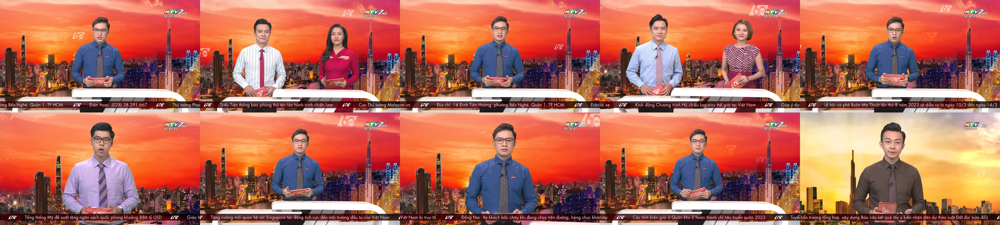

In [ ]:
# ==================================
images = read_image(result)
visualize(images)

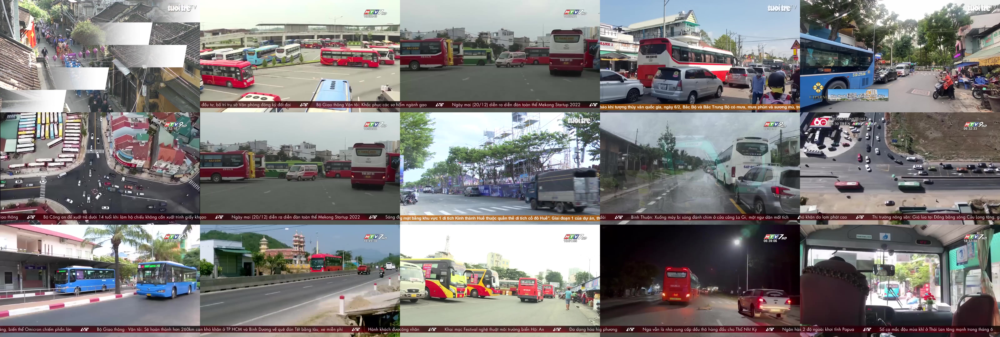

In [ ]:
#@title Base System

from IPython.display import clear_output

clear_output()

#text_query = ["one woman,yellow shirt,Dark green trash can,red lid"] #@param {type:"string"}
text_query = ["Two three-wheeled bicycles dressed up to look like damasons are circling on the road."] #@param {type:"string"}

#L06_V001/0010.jpg
topk = 16 #@param {type:"slider", min:0, max:50, step:1}
measure_method = 'cosin_similarity' #@param ["dot_product", "l1_norm","l2_norm","cosin_similarity","cosin_euclid"]


text_feat_arr = text_embedd(text_query)
search_result = search_engine(text_feat_arr,db, int(topk), measure_method)
images = read_image(search_result)
visualize(images)

In [ ]:
search_result

In [ ]:
#hàm map keyframe
import pandas as pd
PATH_TO_FILE_MAP='/content/drive/MyDrive/ColabNotebooks_2/AI_CHALLENGE_2023/Dataset/map-keyframes/'
def map_keyframe(video_name,key_frame_id):
  df=pd.read_csv(PATH_TO_FILE_MAP+video_name+'.csv')
  return video_name+',',df.frame_idx[key_frame_id-1]

In [ ]:
map_keyframe('L01_V008',217)

('L01_V008,', 23043)

#Nộp thử nghiệm

In [ ]:
querys=['one woman,yellow shirt,Dark green trash can,red lid', '\n'
        'SUV Car with yellow license plate, Toyota brand, collides with roadside tree, beside the car is a sign indicating an intersection with a non-priority road', '\n'
        'two policemen, wearing green shirts, one standing, holding a 1/2 helmet, one sitting in a car, wearing a 3/4 helmet, a motorbike','\n'
        'two young men, standing in front of the house, two dogs, there is a tree on the left side of the house','\n'
        'Video about a school of fish forming a heart shape, then they swim in a line, next scene shows some people helping these fish back into the sea.','\n'
        'Three people jogging on the field, a large bag on the track, on the left there is a row of small green trees next to scattered items, on the right is a carpet of grass.']

In [ ]:
query_feas=text_embedd(querys)

In [ ]:
query_feas

array([[ 0.0325   , -0.003437 , -0.08057  , ...,  0.03253  ,  0.05197  ,
         0.02881  ],
       [ 0.04065  , -0.0108   ,  0.00459  , ...,  0.07196  , -0.00813  ,
        -0.000912 ],
       [ 0.00601  ,  0.04733  , -0.0473   , ...,  0.014084 , -0.06012  ,
        -0.005898 ],
       [ 0.01419  ,  0.0594   , -0.0576   , ..., -0.004704 , -0.014694 ,
         0.002089 ],
       [-0.01294  , -0.03012  , -0.02081  , ..., -0.0463   ,  0.00927  ,
         0.0003989],
       [-0.006306 , -0.006783 , -0.0412   , ..., -0.02773  , -0.005493 ,
        -0.01556  ]], dtype=float16)

In [ ]:
for i,query_fea in enumerate(query_feas,1):
  search_result = search_engine(query_fea,db,100, 'cosin_similarity')
  video_names=[]
  frame_idxs=[]
  for result in search_result:
    video_name,frame_idx=map_keyframe(result['video_name'],result['keyframe_id'])
    video_names.append(video_name)
    frame_idxs.append(frame_idx)
  dic={'vd_name':video_names,'fr_id':frame_idxs}
  df=pd.DataFrame(dic)
  df.to_csv('query-'+str(i)+'.csv', index = None, header=False,sep=" ")






#Vòng Sơ Tuyển